In [2]:
# importing libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report, accuracy_score
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import StratifiedKFold
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import PolynomialFeatures, PowerTransformer
from sklearn.metrics import precision_recall_curve, average_precision_score
import random

In [3]:
#loading the dataset
credit = pd.read_csv('creditcard.csv')

credit.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [4]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [5]:
# Explore label class
print('Normal transactions count: ', credit['Class'].value_counts().values[0])
print('Fraudulent transactions count: ', credit['Class'].value_counts().values[1])

Normal transactions count:  284315
Fraudulent transactions count:  492


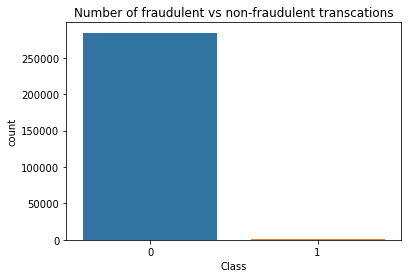

In [5]:
# Bar plot for the number of fraudulent vs non-fraudulent transcations
sns.countplot(x='Class', data=credit)
plt.title('Number of fraudulent vs non-fraudulent transcations')
plt.show()

In [9]:
# Check for null values 
print(f'The data has {credit.isna().sum().sum()} missing values')

The data has 0 missing values


In [8]:
# checking for duplicates
print(f'The data has {credit.duplicated().sum()} duplicates')

The data has 0 duplicates


In [7]:
# Define the subset of columns to check for duplicates
subset_columns = ['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13',
                  'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26',
                  'V27', 'V28', 'Amount']
# Drop duplicates, keeping the original occurrence
credit = credit.drop_duplicates(subset=subset_columns, keep='first')
# checking for duplicates
print(f'The data has {credit.duplicated().sum()} duplicates')

The data has 0 duplicates


In [10]:
# general statistical summary
credit.describe().round(2)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,...,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00,283726.00
mean,94811.08,0.01,-0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,...,-0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,0.00,88.47,0.00
std,47481.05,1.95,1.65,1.51,1.41,1.38,1.33,1.23,1.18,1.10,...,0.72,0.72,0.62,0.61,0.52,0.48,0.40,0.33,250.40,0.04
min,0.00,-56.41,-72.72,-48.33,-5.68,-113.74,-26.16,-43.56,-73.22,-13.43,...,-34.83,-10.93,-44.81,-2.84,-10.30,-2.60,-22.57,-15.43,0.00,0.00
25%,54204.75,-0.92,-0.60,-0.89,-0.85,-0.69,-0.77,-0.55,-0.21,-0.64,...,-0.23,-0.54,-0.16,-0.35,-0.32,-0.33,-0.07,-0.05,5.60,0.00
50%,84692.50,0.02,0.06,0.18,-0.02,-0.05,-0.28,0.04,0.02,-0.05,...,-0.03,0.01,-0.01,0.04,0.02,-0.05,0.00,0.01,22.00,0.00
75%,139298.00,1.32,0.80,1.03,0.74,0.61,0.40,0.57,0.33,0.60,...,0.19,0.53,0.15,0.44,0.35,0.24,0.09,0.08,77.51,0.00
max,172792.00,2.45,22.06,9.38,16.88,34.80,73.30,120.59,20.01,15.59,...,27.20,10.50,22.53,4.58,7.52,3.52,31.61,33.85,25691.16,1.00


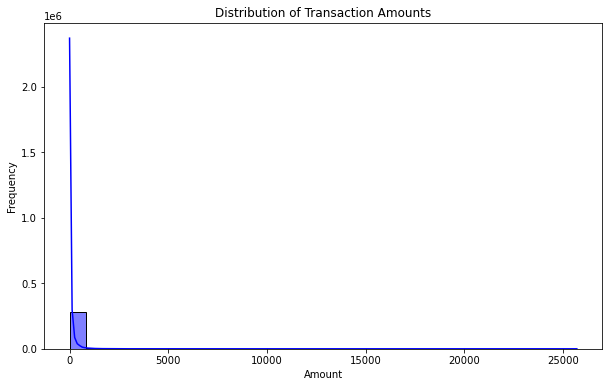

In [11]:
# Plotting the distribution of transaction amounts
plt.figure(figsize=(10, 6))
sns.histplot(credit['Amount'], bins=30, kde=True, color='blue')
plt.title('Distribution of Transaction Amounts')
plt.xlabel('Amount')
plt.ylabel('Frequency')
plt.show()


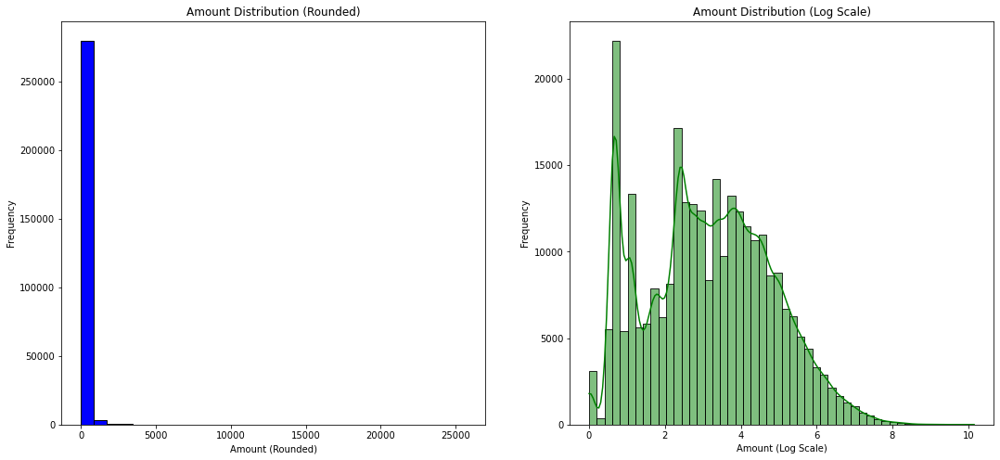

In [11]:
# Let's try to understand the Amount variable as it is not PCA transformed variable :
# Add a small constant to handle zero or negative values
credit['Amount_log'] = np.log1p(credit['Amount'])

plt.figure(figsize=(18, 8))

plt.subplot(1, 2, 1)
plt.title('Amount Distribution (Rounded)')
credit['Amount'].round(0).astype(int).plot.hist(bins=30, color='blue', edgecolor='black')
plt.xlabel("Amount (Rounded)")
plt.ylabel("Frequency")

plt.subplot(1, 2, 2)
plt.title('Amount Distribution (Log Scale)')
sns.histplot(credit['Amount_log'], bins=50, kde=True, color='green', edgecolor='black')
plt.xlabel("Amount (Log Scale)")
plt.ylabel("Frequency")

plt.show()


**Time Elapsed Since First Transaction**

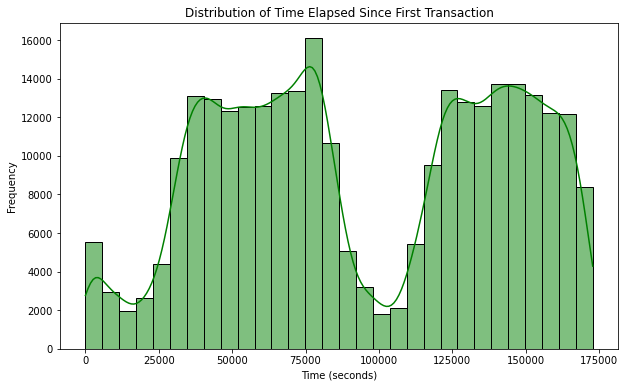

In [12]:
# Plotting the distribution of time elapsed since the first transaction
plt.figure(figsize=(10, 6))
sns.histplot(credit['Time'], bins=30, kde=True, color='green')
plt.title('Distribution of Time Elapsed Since First Transaction')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency')
plt.show()


**Analysis:**

The distribution of time elapsed since the first transaction reveals a pattern where certain time intervals experience higher transaction frequencies. 

**Fraud vs. Amount**

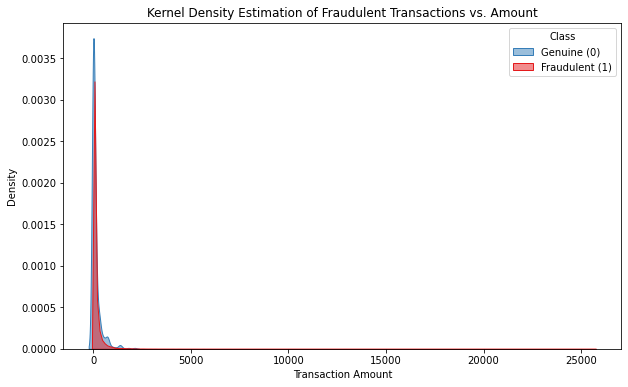

In [13]:
# KDE plots to compare Fraud vs. Amount
plt.figure(figsize=(10, 6))
sns.kdeplot(data=credit, x='Amount', hue='Class', common_norm=False, fill=True, palette='Set1', alpha=0.5)
plt.title('Kernel Density Estimation of Fraudulent Transactions vs. Amount')
plt.xlabel('Transaction Amount')
plt.ylabel('Density')
plt.legend(title='Class', labels=['Genuine (0)', 'Fraudulent (1)'])
plt.show()


In [14]:
import plotly.express as px

fig = px.scatter(x=credit['Time'], y=credit['Class'], color=credit['Class'])
fig.update_layout(title='Distribution of Classes with Time', xaxis_title='Time (seconds)', yaxis_title='Class')
fig.show()


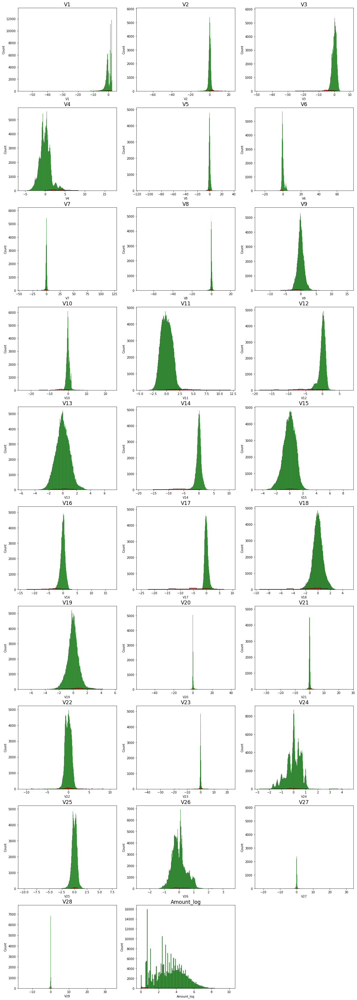

In [16]:
# dropping 'amount' and 'time' to see the distribution in other cols
pca_cols = credit.drop(['Amount', 'Time','Class'], axis=1)
cols = list(pca_cols.columns.values)
# plot the histogram of a variable from the dataset to see the skewness
normal_records = credit.Class == 0
fraud_records = credit.Class == 1

plt.figure(figsize=(20, 60))
for n, col in enumerate(cols):
    plt.subplot(10,3,n+1)
    sns.histplot(pca_cols[col][normal_records], color='green')
    sns.histplot(pca_cols[col][fraud_records], color='red')
    plt.title(col, fontsize=17)
plt.show()

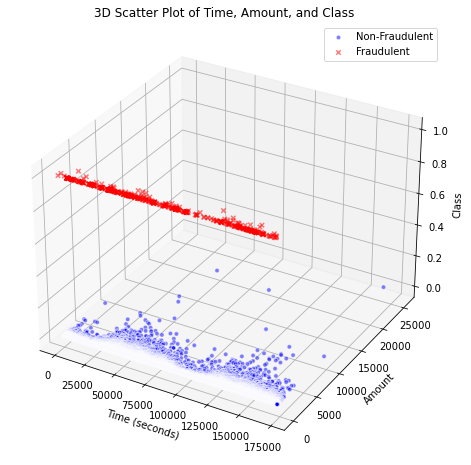

In [17]:
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D scatter plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot for non-fraudulent transactions
ax.scatter(credit[credit['Class'] == 0]['Time'],
           credit[credit['Class'] == 0]['Amount'],
           zs=0, label='Non-Fraudulent', c='blue', alpha=0.5, edgecolors='w', marker='o')

# Scatter plot for fraudulent transactions
ax.scatter(credit[credit['Class'] == 1]['Time'],
           credit[credit['Class'] == 1]['Amount'],
           zs=1, label='Fraudulent', c='red', alpha=0.5, edgecolors='w', marker='x')

ax.set_xlabel('Time (seconds)')
ax.set_ylabel('Amount')
ax.set_zlabel('Class')

plt.title('3D Scatter Plot of Time, Amount, and Class')
plt.legend()
plt.show()

In [18]:
#checking for correlation
cor = credit.corr()
cor

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V22,V23,V24,V25,V26,V27,V28,Amount,Class,Amount_log
Time,1.000000,0.117927,-0.010556,-0.422054,-0.105845,0.173223,-0.063279,0.085335,-0.038203,-0.007861,...,0.143727,0.051474,-0.015954,-0.233262,-0.041818,-0.005171,-0.009305,-0.010559,-0.012359,-0.028327
V1,0.117927,1.000000,0.006875,-0.008112,0.002257,-0.007036,0.000413,-0.009173,-0.001168,0.001828,...,-0.001436,-0.001330,-0.000723,-0.000222,-0.000684,-0.015706,-0.004861,-0.230105,-0.094486,-0.097754
V2,-0.010556,0.006875,1.000000,0.005278,-0.001495,0.005210,-0.000594,0.007425,0.002899,-0.000274,...,0.001237,-0.003855,0.000701,-0.001569,0.000253,0.007555,0.001611,-0.533428,0.084624,-0.451640
V3,-0.422054,-0.008112,0.005278,1.000000,0.002829,-0.006879,-0.001511,-0.011721,-0.001815,-0.003579,...,-0.000275,0.000449,-0.000072,0.000425,-0.000094,-0.007051,-0.000134,-0.212410,-0.182322,-0.034509
V4,-0.105845,0.002257,-0.001495,0.002829,1.000000,0.001744,-0.000880,0.004657,0.000890,0.002154,...,0.000115,0.000732,-0.000120,0.000162,0.000777,0.001322,0.000231,0.099514,0.129326,-0.003420
V5,0.173223,-0.007036,0.005210,-0.006879,0.001744,1.000000,-0.000938,-0.008709,0.001430,-0.001213,...,-0.000559,0.001183,0.000198,0.000069,0.000390,-0.005798,-0.000820,-0.387685,-0.087812,-0.287043
V6,-0.063279,0.000413,-0.000594,-0.001511,-0.000880,-0.000938,1.000000,0.000436,0.003036,-0.000734,...,0.001104,-0.000755,0.001202,0.000697,-0.000028,0.000289,0.000925,0.216389,-0.043915,0.164575
V7,0.085335,-0.009173,0.007425,-0.011721,0.004657,-0.008709,0.000436,1.000000,-0.006419,-0.004921,...,-0.002280,0.003303,-0.000384,-0.000072,0.000624,-0.004537,0.001657,0.400408,-0.172347,0.095617
V8,-0.038203,-0.001168,0.002899,-0.001815,0.000890,0.001430,0.003036,-0.006419,1.000000,0.001038,...,-0.006156,0.004994,0.000113,0.000011,-0.001407,0.000613,-0.000099,-0.104662,0.033068,-0.022308
V9,-0.007861,0.001828,-0.000274,-0.003579,0.002154,-0.001213,-0.000734,-0.004921,0.001038,1.000000,...,0.000785,0.000677,-0.000103,-0.000275,0.001253,0.008221,0.005591,-0.044123,-0.094021,-0.081211


Heatmap

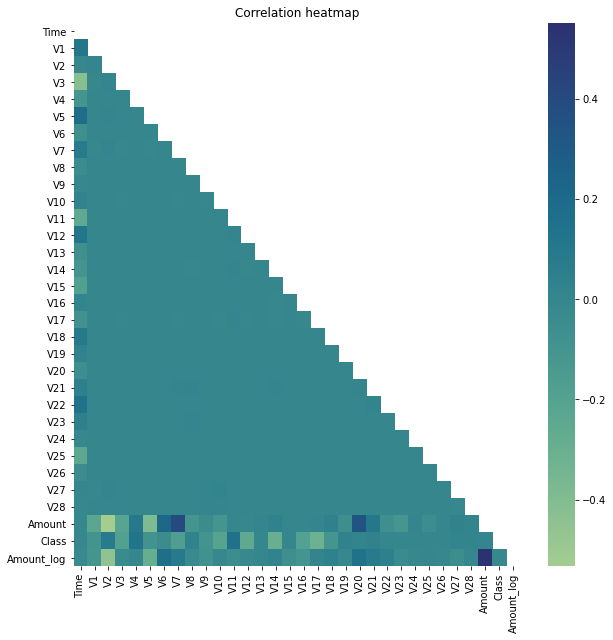

In [19]:
# Heat map for the survived data correlation coeficients
plt.figure(figsize=(10, 10))
plt.title('Correlation heatmap')
corr=credit.corr()
mask=np.triu(corr)
sns.heatmap(corr,cmap='crest',mask=mask)
plt.show()


In [20]:
# Split the data into features (X) and target variable (y)
X = credit.drop(['Class', 'Amount_log'], axis=1)
y = credit['Class']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

X_train shape: (226980, 30)
X_test shape: (56746, 30)
y_train shape: (226980,)
y_test shape: (56746,)


### `5.1 Baseline Model`

As a baseline, train a vanilla `logistic regression model`. Then plot the ROC curve and print out the AUC. We'll use this as a comparison for how our future models perform.

C:\Users\Sharo\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



AUPRC: 0.5035587176290144


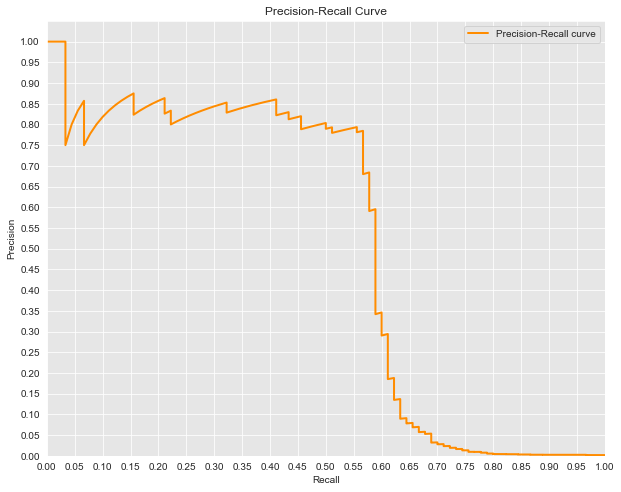

In [21]:
from sklearn.metrics import precision_recall_curve, auc
logreg = LogisticRegression()
# Probability scores for the test set
y_score = logreg.fit(X_train, y_train).decision_function(X_test)

# Precision, recall, and thresholds
precision, recall, thresholds = precision_recall_curve(y_test, y_score)

# Calculate AUPRC
auprc = auc(recall, precision)

# Seaborn's beautiful styling
sns.set_style('darkgrid', {'axes.facecolor': '0.9'})

# Print AUPRC
print('AUPRC: {}'.format(auprc))

# Plot the Precision-Recall curve
plt.figure(figsize=(10, 8))
lw = 2
plt.plot(recall, precision, color='darkorange',
         lw=lw, label='Precision-Recall curve')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.yticks([i/20.0 for i in range(21)])
plt.xticks([i/20.0 for i in range(21)])
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc='upper right')
plt.show()


In [22]:
# Instantiate the scaler
scaler = StandardScaler()

# Fit the scaler on the training data and transform both training and test data
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [23]:
print(X_test_scaled)

[[-0.5387895   0.53896015 -0.46199837 ...  0.25187121  0.12029052
  -0.12711384]
 [-0.29510086 -2.46852622  2.64018286 ...  1.08277702 -1.33294066
  -0.31173338]
 [-1.12859855 -0.79769251 -0.15662003 ... -1.2701668  -0.76122569
  -0.16807877]
 ...
 [ 0.6708949   1.01232783 -0.18483459 ... -0.21554244 -0.18268072
  -0.21997826]
 [-0.96683426 -1.46398734 -1.41475957 ...  0.64493323 -1.09651024
   0.01289592]
 [ 1.39457058 -0.03594487  0.47606942 ...  1.45557384  0.96007385
  -0.31300115]]


### ` Handling Class Imbalance`

`SMOTE`

Use the SMOTE class from the imblearn package in order to improve the model's performance on the minority class.

In [24]:
from imblearn.over_sampling import SMOTE
# Previous original class distribution
print(y_train.value_counts()) 

# Fit SMOTE to training data
X_train_resampled, y_train_resampled = SMOTE().fit_resample(X_train_scaled, y_train) 

# Preview synthetic sample class distribution
print('\n')
print(pd.Series(y_train_resampled).value_counts()) 

0    226597
1       383
Name: Class, dtype: int64


1    226597
0    226597
Name: Class, dtype: int64


`Creating class for modelling`

In [25]:

class BinaryClassificationModel:
    def __init__(self, classifier):
        self.classifier = classifier
    
    def train_and_predict(self, X_train, y_train, X_test, subset=False):
        if subset:
            self.classifier.fit(X_train[:10000], y_train[:10000])
        else:
            self.classifier.fit(X_train, y_train)
        
        self.y_pred = self.classifier.predict(X_test)
        self.y_prob = self.classifier.predict_proba(X_test)[:, 1]
    
    
    def evaluate(self, y_true):
        self.classification_report(y_true)
        
        self.plot_confusion_matrix(y_true)
        self.plot_roc_curve(y_true)
        
        auprc = self.calculate_auprc(y_true)
        print(f"The model has an AUPRC score of {auprc:.2%}")
        print("-" * 45)
    
    def calculate_auprc(self, y_true):
        precision, recall, thresholds = precision_recall_curve(y_true, self.y_prob)
        return auc(recall, precision)
    
    def classification_report(self, y_true):
        # Import necessary libraries
        
        # Generate classification report
        report = classification_report(y_true, self.y_pred)
        print("Classification Report:")
        print(report)
    
    def plot_confusion_matrix(self, y_true):
        # Import necessary libraries
        from sklearn.metrics import confusion_matrix
        import seaborn as sns
        
        # Generate confusion matrix
        cm = confusion_matrix(y_true, self.y_pred)
        sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", cbar=False)
        plt.title("Confusion Matrix")
        plt.xlabel("Predicted")
        plt.ylabel("True")
        plt.show()
    
    def plot_roc_curve(self, y_true):
        # Calculate False Positive Rate (FPR), True Positive Rate (TPR), and thresholds
        fpr, tpr, thresholds = roc_curve(y_true, self.y_prob)
        
        # Calculate Area Under the ROC Curve (AUROC)
        roc_auc = auc(fpr, tpr)
        
        # Plot ROC curve
        plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (AUC = %0.2f)' % roc_auc)
        plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic')
        plt.legend(loc="lower right")
        plt.show()

#### `Logistic regression after scaling and sampling`

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.77      0.48      0.59        90

    accuracy                           1.00     56746
   macro avg       0.88      0.74      0.79     56746
weighted avg       1.00      1.00      1.00     56746



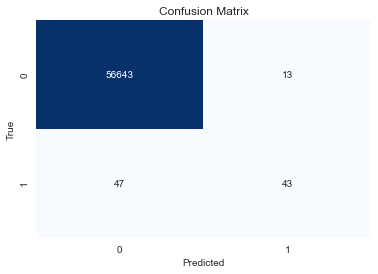

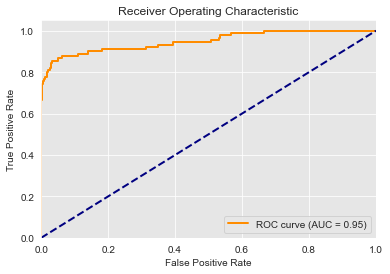

The model has an AUPRC score of 59.47%
---------------------------------------------


In [26]:
#instantiate the model
log_classifier = LogisticRegression(random_state=42)
log = BinaryClassificationModel(log_classifier)

#evaliating the model
log.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
log.evaluate(y_test)


Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       1.00      0.06      0.11        90

    accuracy                           1.00     56746
   macro avg       1.00      0.53      0.55     56746
weighted avg       1.00      1.00      1.00     56746



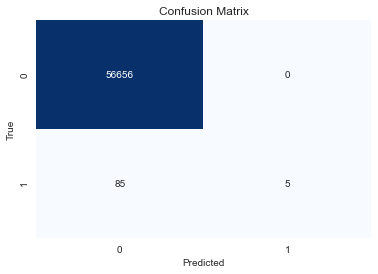

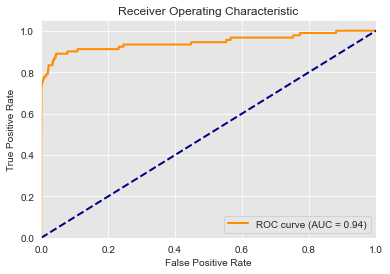

The model has an AUPRC score of 64.10%
---------------------------------------------


In [27]:
#instantiating  and fitting the model
svm_classifier = SVC(probability=True)
svm = BinaryClassificationModel(svm_classifier)
#evaliating model performance
svm.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
svm.evaluate(y_test)


Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.88      0.71      0.79        90

    accuracy                           1.00     56746
   macro avg       0.94      0.86      0.89     56746
weighted avg       1.00      1.00      1.00     56746



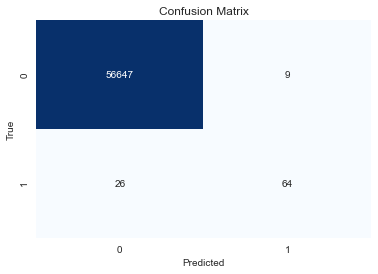

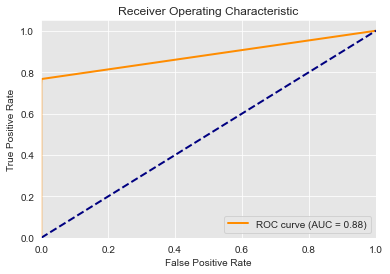

The model has an AUPRC score of 75.96%
---------------------------------------------


In [28]:
# Instantiate the KNN classifier
knn_classifier = KNeighborsClassifier()

# Create an instance of the BinaryClassificationModel class with the KNN classifier
knn = BinaryClassificationModel(knn_classifier)

# Train, predict, and evaluate using the hybrid sampled data
knn.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
knn.evaluate(y_test)


Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     56656
           1       0.07      0.74      0.12        90

    accuracy                           0.98     56746
   macro avg       0.53      0.86      0.56     56746
weighted avg       1.00      0.98      0.99     56746



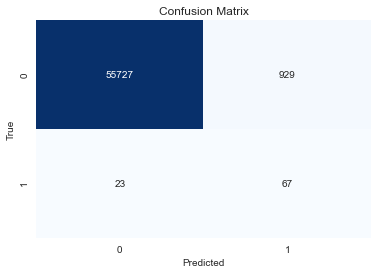

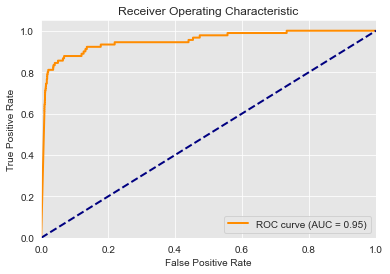

The model has an AUPRC score of 34.19%
---------------------------------------------


In [29]:
# Instantiate the Naive Bayes classifier
nb_classifier = GaussianNB()

# Create an instance of the BinaryClassificationModel with Naive Bayes classifier
nb = BinaryClassificationModel(nb_classifier)

# Train and predict using Naive Bayes
nb.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
nb.evaluate(y_test)


Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.69      0.51      0.59        90

    accuracy                           1.00     56746
   macro avg       0.84      0.76      0.79     56746
weighted avg       1.00      1.00      1.00     56746



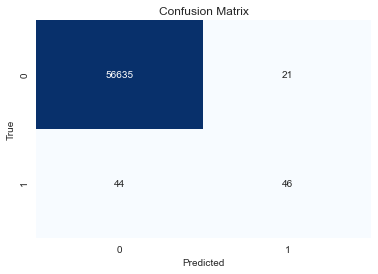

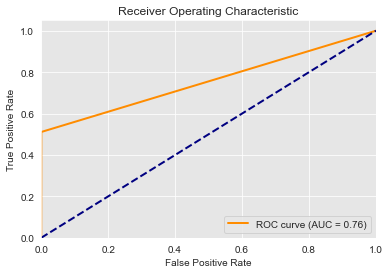

The model has an AUPRC score of 59.92%
---------------------------------------------


In [30]:

#instantiating and fitiing the model
classifier = DecisionTreeClassifier(random_state=42)
dt = BinaryClassificationModel(classifier)
#evaluating the model performance
dt.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
dt.evaluate(y_test)

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.94      0.53      0.68        90

    accuracy                           1.00     56746
   macro avg       0.97      0.77      0.84     56746
weighted avg       1.00      1.00      1.00     56746



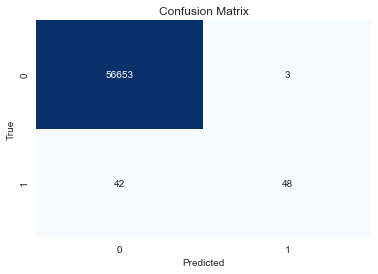

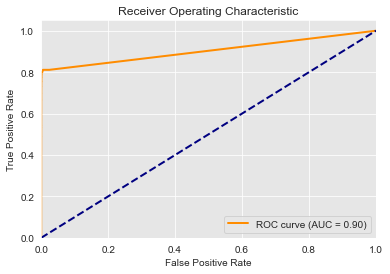

The model has an AUPRC score of 75.56%
---------------------------------------------


In [31]:
# Instantiate and fit the Random Forest classifier
rf_classifier = RandomForestClassifier(random_state=42)
rf = BinaryClassificationModel(rf_classifier)

# Evaluate the model performance on the resampled and scaled data
rf.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
rf.evaluate(y_test)

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.89      0.61      0.72        90

    accuracy                           1.00     56746
   macro avg       0.94      0.81      0.86     56746
weighted avg       1.00      1.00      1.00     56746



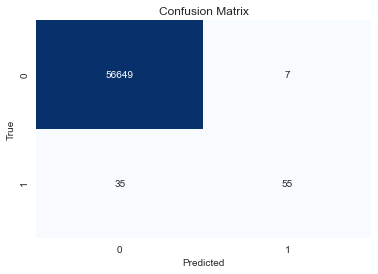

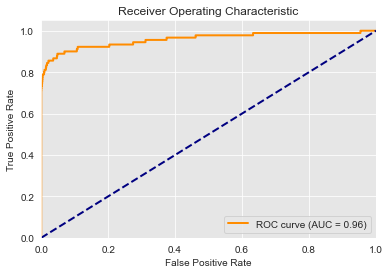

The model has an AUPRC score of 70.23%
---------------------------------------------


In [32]:
# Instantiate and fit the XGBoost classifier
xgb_classifier = XGBClassifier(random_state=42)
xgb = BinaryClassificationModel(xgb_classifier)

# Evaluate the model performance on the resampled and scaled data
xgb.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
xgb.evaluate(y_test)

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.76      0.32      0.45        90

    accuracy                           1.00     56746
   macro avg       0.88      0.66      0.73     56746
weighted avg       1.00      1.00      1.00     56746



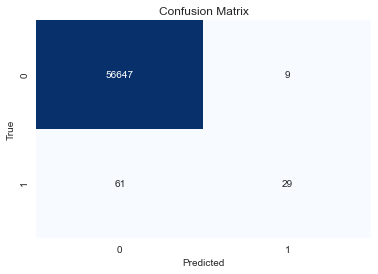

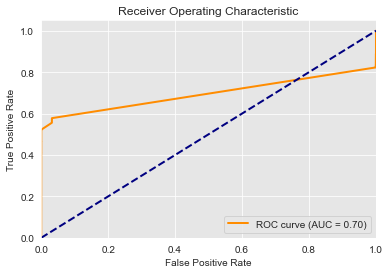

The model has an AUPRC score of 44.15%
---------------------------------------------


In [33]:
# Instantiate and fit the Gradient Boosting classifier
gb_classifier = GradientBoostingClassifier(random_state=42)
gb = BinaryClassificationModel(gb_classifier)

# Evaluate the model performance on the resampled and scaled data
gb.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=True)
gb.evaluate(y_test)

#### `Tuning Logistic Regression with Regularization`

In [34]:
from sklearn.metrics import make_scorer
# Instantiate Logistic Regression
logreg = LogisticRegression(solver='liblinear')

# Define the grid of hyperparameters to search
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  # Regularization strength (inverse of alpha)
}

# Use AUPRC as the scoring metric
auprc_scorer = make_scorer(average_precision_score, greater_is_better=True, needs_proba=True)

# Use GridSearchCV to find the best hyperparameters
grid_search = GridSearchCV(logreg, param_grid, cv=5, scoring=auprc_scorer)
grid_search.fit(X_train_resampled, y_train_resampled)

# Get the best hyperparameters
best_params = grid_search.best_params_

# Instantiate a new Logistic Regression model with the best hyperparameters
best_logreg = LogisticRegression(solver='liblinear', **best_params)

# Train the model
best_logreg.fit(X_train_resampled, y_train_resampled )

LogisticRegression(C=100, solver='liblinear')

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.00      0.00      0.00        90

    accuracy                           1.00     56746
   macro avg       0.50      0.50      0.50     56746
weighted avg       1.00      1.00      1.00     56746



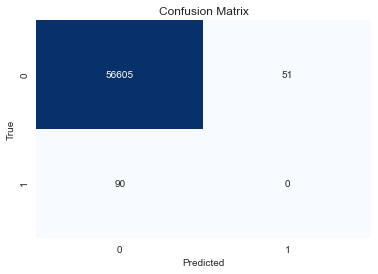

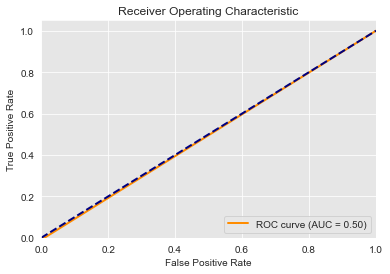

The model has an AUPRC score of 0.08%
---------------------------------------------


In [35]:

logreg_model = BinaryClassificationModel(best_logreg)

# Train and predict
logreg_model.train_and_predict(X_train_resampled, y_train_resampled, X_test)

# Evaluate
logreg_model.evaluate(y_test)

#### `Tuning the Random Forest with gridsearch`

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56656
           1       0.21      0.83      0.34        90

    accuracy                           0.99     56746
   macro avg       0.61      0.91      0.67     56746
weighted avg       1.00      0.99      1.00     56746



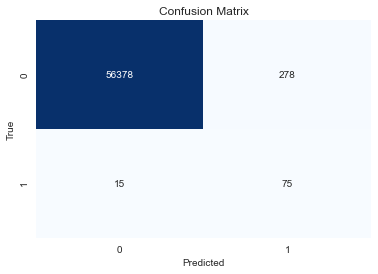

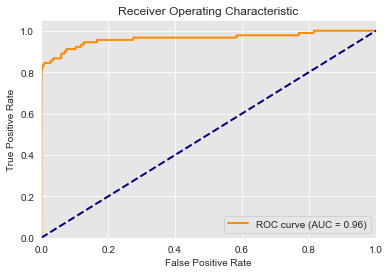

The model has an AUPRC score of 68.91%
---------------------------------------------


In [36]:
best_rf_params = {'max_depth': 3, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 75}
# Instantiate and fit the Random Forest classifier
rf_classifier = RandomForestClassifier(random_state=42, **best_rf_params)
rf_tuned = BinaryClassificationModel(rf_classifier)

# Evaluate the model performance on the resampled and scaled data
rf_tuned.train_and_predict(X_train_resampled, y_train_resampled, X_test_scaled, subset=False)
rf_tuned.evaluate(y_test)


In [37]:
from sklearn.model_selection import StratifiedKFold

skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize scaler and SMOTE
scaler = StandardScaler()
smote = SMOTE(random_state=42)

X_train_reset = X_train.reset_index(drop=True)

# Perform cross-validation
for train_index, val_index in skf.split(X_train_reset, y_train):
    X_train_cv, X_val = X_train_reset.iloc[train_index], X_train_reset.iloc[val_index]
    y_train_cv, y_val = y_train.iloc[train_index], y_train.iloc[val_index]

    # Scale features
    X_train_scaled = scaler.fit_transform(X_train_cv)
    X_val_scaled = scaler.transform(X_val)
    
    # Apply SMOTE to the training data (oversampling the minority class)
    X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train_cv)
    

In [38]:
# Preview synthetic sample class distribution
print('\n')
print(pd.Series(y_train_resampled).value_counts()) 



1    181278
0    181278
Name: Class, dtype: int64


#### `KNN model in cross validation`

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     45319
           1       0.86      0.66      0.75        77

    accuracy                           1.00     45396
   macro avg       0.93      0.83      0.87     45396
weighted avg       1.00      1.00      1.00     45396



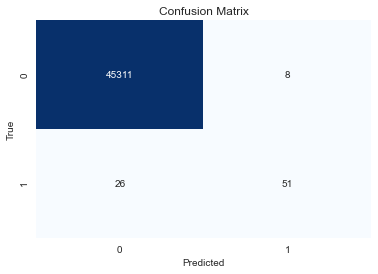

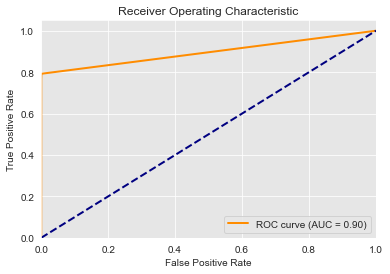

The model has an AUPRC score of 76.04%
---------------------------------------------


In [39]:
#instantiate the model
knn_classifier = KNeighborsClassifier()
knn_cv = BinaryClassificationModel(knn_classifier)

#evaliating the model
knn_cv.train_and_predict(X_train_resampled, y_train_resampled, X_val_scaled, subset=True)
knn_cv.evaluate(y_val)

#### `Random Forest model in cross validation`

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     45319
           1       0.88      0.79      0.84        77

    accuracy                           1.00     45396
   macro avg       0.94      0.90      0.92     45396
weighted avg       1.00      1.00      1.00     45396



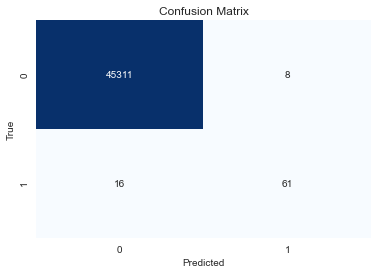

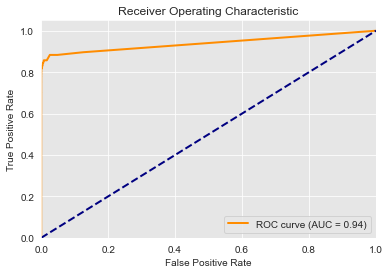

The model has an AUPRC score of 81.03%
---------------------------------------------


In [40]:
# Instantiate and fit the Random Forest classifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_cv = BinaryClassificationModel(rf_classifier)

#evaluating the model performance
rf_cv.train_and_predict(X_train_resampled, y_train_resampled, X_val_scaled, subset=False)
rf_cv.evaluate(y_val) 

#### `XGboost model with cross validation`


Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     45319
           1       0.78      0.81      0.79        77

    accuracy                           1.00     45396
   macro avg       0.89      0.90      0.89     45396
weighted avg       1.00      1.00      1.00     45396



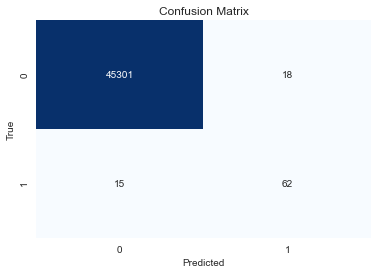

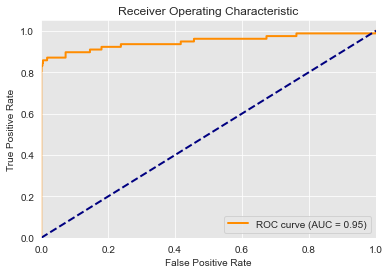

The model has an AUPRC score of 82.59%
---------------------------------------------


In [41]:
# Instantiate and fit the XGBoost classifier
xgb_classifier = XGBClassifier(random_state=42)
xgb_cv = BinaryClassificationModel(xgb_classifier)

#evaluating the model performance
xgb_cv.train_and_predict(X_train_resampled, y_train_resampled, X_val_scaled, subset=False)
xgb_cv.evaluate(y_val)

In [42]:
print(X_train_resampled.shape)
print(y_train_resampled.shape)
print(X_val_scaled.shape)
print(y_test.shape)
print(X_test_scaled.shape)

(362556, 30)
(362556,)
(45396, 30)
(56746,)
(56746, 30)


Epoch 1/10
11330/11330 [==============================] - 27s 2ms/step - loss: 0.0326
Epoch 2/10
11330/11330 [==============================] - 19s 2ms/step - loss: 0.0093
Epoch 3/10
11330/11330 [==============================] - 26s 2ms/step - loss: 0.0073
Epoch 4/10
11330/11330 [==============================] - 23s 2ms/step - loss: 0.0063
Epoch 5/10
11330/11330 [==============================] - 22s 2ms/step - loss: 0.0056
Epoch 6/10
11330/11330 [==============================] - 23s 2ms/step - loss: 0.0053
Epoch 7/10
11330/11330 [==============================] - 23s 2ms/step - loss: 0.0052
Epoch 8/10
11330/11330 [==============================] - 25s 2ms/step - loss: 0.0047
Epoch 9/10
11330/11330 [==============================] - 21s 2ms/step - loss: 0.0044
Epoch 10/10
11330/11330 [==============================] - 23s 2ms/step - loss: 0.0045
Instructions for updating:
Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (

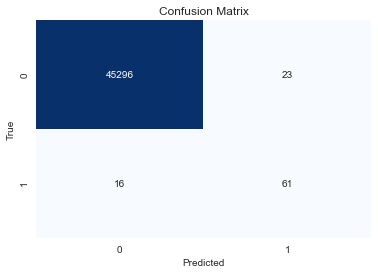

AUPRC: 77.45%


In [44]:
import tensorflow as tf
# Define your neural network model
nn = tf.keras.models.Sequential([
    tf.keras.layers.Dense(128, activation='relu', input_shape=(30,)),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

# Compile the model
nn.compile(optimizer='adam', loss='binary_crossentropy')

# Train the model
history = nn.fit(X_train_resampled, y_train_resampled, epochs=10, batch_size=32)

# Evaluate the model
y_pred = nn.predict_classes(X_val_scaled)
y_prob = nn.predict(X_val_scaled)

print("Classification Report:")
print(classification_report(y_val, y_pred))

cm = confusion_matrix(y_val, y_pred)
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", cbar=False)
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.show()

precision, recall, thresholds = precision_recall_curve(y_val, y_prob)
auprc = auc(recall, precision)
print(f"AUPRC: {auprc:.2%}")